# This cat does not exist
__Суммарное количество баллов: 10__

__Решение отправлять на `ml.course.practice@gmail.com`__

__Тема письма: `[ML][MS][HW06] <ФИО>`, где вместо `<ФИО>` указаны фамилия и имя__

Цель этого задания - создать котов, которых не существует. В ходе данного задания вы обучите DCGAN и VAE, которые являются одними из первых генеративных моделей. Для этого задания вам наверняка потребуется GPU с CUDA, поэтому рекомендуется использовать Google Colab.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path = '/content/drive/MyDrive/Colab Notebooks/cat_136'

In [ ]:
!unzip cat_136.zip

In [29]:
import torch
from torch import nn
from torch.optim import Adam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os 
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np

%matplotlib inline

In [30]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size).cuda()

def imagewide_average(x):
    return x.mean(dim=(-1, -2))

In [31]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [20]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset='cat_136', size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size
    
    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:512 - crop_rate + x_crop, y_crop:512 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size), interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1
    
    def __len__(self):
        return len(self.photo_names)

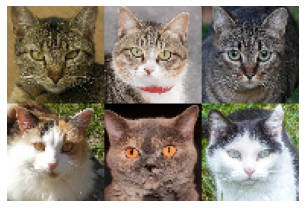

In [21]:
dataset = CatDataset()
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

### Задание 1 (2 балла)
Для начала реализуем генератор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ConvTranspose2D`, `nn.ReLU`, а также функция `F.interpolate`.

#### Методы
* `__init__` - принимает на вход `start_size`, `latent_channels`, `start_channels` и `upsamplings`. Первые два аргумента отвечают за размер случайного шума, из которого в последствии будет сгенерирована картинка. `start_channels` отвечает за то, сколько каналов должно быть в картинке перед тем, как к ней будут применены upsampling блоки. `upsamplings` - это количество upsampling блоков, которые должны быть применены к картинке. В каждом таком локе количество каналов уменьшается в два раза.


* `forward` - принимает на вход `batch_size`, генерирует `batch_size` картинок из случайного шума.

In [47]:
class Generator(nn.Module):

    def __init__(self, start_size=2, latent_channels=32, start_channels=1024, upsamplings=6):
        super(Generator, self).__init__()
        self.start_size = start_size
        self.latent_channels = latent_channels
        self.start_channels = start_channels
        self.upsamplings = upsamplings
        self.net()
        self.encoder = self.net()
        self.tanh = nn.Tanh()


    def net(self):
      conv1 = nn.Conv2d(self.latent_channels, self.start_channels, kernel_size=1, stride=1, padding=0, bias=False)
      conv_blocks = []
      c = self.start_channels
      for i in range(self.upsamplings):
          c_ = c // 2
          conv_blocks += [nn.ConvTranspose2d(c, c_, kernel_size=4, stride=2, padding=1, bias=False),\
                nn.InstanceNorm2d(c_),\
                nn.LeakyReLU()]
          c = c_    
      conv2 = nn.Conv2d(c_, 3, kernel_size=1, stride=1, padding=0)
      conv_blocks = [conv1] + conv_blocks + [conv2]
      encoder = nn.Sequential(*conv_blocks)
      return encoder


    def forward(self, batch_size: int):
        x = torch.randn(batch_size, self.latent_channels, self.start_size, self.start_size).cuda()        
        x = self.encoder(x)
        return self.tanh(x) # torch.Tensor batch_size x 3 x (start_size * 2**upsamplings) x (start_size * 2**upsamplings)


### Задание 2 (2 балла)
Для начала реализуем дискриминатор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/Disc_DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ReLU` и `nn.Sigmoid`.

#### Методы
* `__init__` - принимает на вход `start_channels` и `downsamplings`. `start_channels` определяет количество каналов, которые должны быть в изображении перед применением downsampling блоков.


* `forward` - принимает на вход `x` - тензор с картинками. Возвращает вектор с размерностью `batch_size`.

In [50]:
class Discriminator(nn.Module):

    def __init__(self, downsamplings=6, start_channels=8):
        super(Discriminator, self).__init__()
        self.start_channels = start_channels
        self.downsamplings = downsamplings
        self.net()
        self.encoder = self.net()
        self.sigmoid = nn.Sigmoid()


    def net(self):
      conv1 = nn.Conv2d(3, self.start_channels, kernel_size=1, stride=1, padding=0)
      conv_blocks = []
      c = self.start_channels
      for i in range(self.downsamplings):
          c_ = c * 2
          conv_blocks += [nn.Conv2d(c, c_, kernel_size=3, stride=2, padding=1),
            nn.InstanceNorm2d(c_),
            nn.Dropout(p=0.2),
            nn.LeakyReLU()]
          c = c_
      flatten = nn.Flatten()
      linear = nn.Linear(c*4, 1)
      conv_blocks = [conv1] + conv_blocks + [flatten] + [linear]
      encoder = nn.Sequential(*conv_blocks)
      return encoder


    def forward(self, x):     
        x = self.encoder(x)
        return self.sigmoid(x) # torch.Tensor batch_size x 1  


In [51]:
def train_gan():
    generator = Generator()
    discriminator = Discriminator()
    epochs = 120
    visualise_every = 10
    batch_size = 8
    generator.cuda()
    discriminator.cuda()

    gen_optim = Adam(generator.parameters(), lr=1e-4, betas=(0.5, 0.999))
    disc_optim = Adam(discriminator.parameters(), lr=1e-4, betas=(0.5, 0.999))

    dataset = CatDataset(size=128)

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        gen_loss_avg = 0
        disc_loss_avg = 0

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            # Positive update
            batch = batch.cuda()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Negative update
            batch = generator(batch_size).detach()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.zeros_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Generator update
            batch = generator(batch_size)
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            gen_optim.zero_grad()
            loss.backward()
            gen_optim.step()
            gen_loss_avg += loss.item()
        
        if (ep + 1) % visualise_every == 0:
            with torch.no_grad():
                visualise(generator(6), rows=2)

        print(f"Epoch {ep+1} | Discriminator loss: {disc_loss_avg / total_batches} | Generator loss: {gen_loss_avg / total_batches}")


Epoch 1 | Discriminator loss: 0.436776847241993 | Generator loss: 3.293188502236923



Epoch 2 | Discriminator loss: 0.6031806491740533 | Generator loss: 2.805822917578383



Epoch 3 | Discriminator loss: 0.6070612158224288 | Generator loss: 2.860476989553582



Epoch 4 | Discriminator loss: 0.8290766865934783 | Generator loss: 2.086213853788672



Epoch 5 | Discriminator loss: 0.7342667580856157 | Generator loss: 2.5132734327582837



Epoch 6 | Discriminator loss: 0.8603882534271801 | Generator loss: 2.1706022999671677



Epoch 7 | Discriminator loss: 0.9649388431969116 | Generator loss: 1.6131947837446048



Epoch 8 | Discriminator loss: 0.8838153195624191 | Generator loss: 1.8089497720602876



Epoch 9 | Discriminator loss: 0.8433208074565306 | Generator loss: 1.8796265763895852


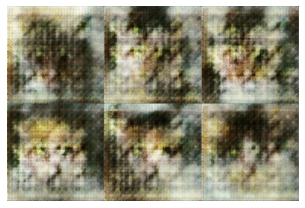

Epoch 10 | Discriminator loss: 0.8245523782896734 | Generator loss: 1.9129295437972738



Epoch 11 | Discriminator loss: 0.7852926629563644 | Generator loss: 1.9963012021150648



Epoch 12 | Discriminator loss: 0.7397137958656198 | Generator loss: 2.2206564388289953



Epoch 13 | Discriminator loss: 0.7801004875811418 | Generator loss: 2.0220861192445576



Epoch 14 | Discriminator loss: 0.29797957191205443 | Generator loss: 4.159334622925113



Epoch 15 | Discriminator loss: 0.6414897077416268 | Generator loss: 2.853987839096081



Epoch 16 | Discriminator loss: 0.735628390988416 | Generator loss: 2.2695807424946604



Epoch 17 | Discriminator loss: 0.6600722443636073 | Generator loss: 2.570561438058474



Epoch 18 | Discriminator loss: 0.7346706875594136 | Generator loss: 2.3734706001622334



Epoch 19 | Discriminator loss: 0.5022805163173176 | Generator loss: 3.0003318042488574


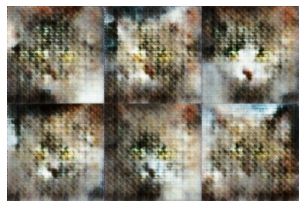

Epoch 20 | Discriminator loss: 0.4695175657387221 | Generator loss: 3.577278123323962



Epoch 21 | Discriminator loss: 0.7131335493508887 | Generator loss: 2.419783398231364



Epoch 22 | Discriminator loss: 0.6824031925086121 | Generator loss: 2.397836783750457



Epoch 23 | Discriminator loss: 0.6706372285933759 | Generator loss: 2.5187091420155876



Epoch 24 | Discriminator loss: 0.6447723662577062 | Generator loss: 2.534132340679998



Epoch 25 | Discriminator loss: 0.5662664007332293 | Generator loss: 2.767465030184444



Epoch 26 | Discriminator loss: 0.6403040099784284 | Generator loss: 2.7750639408271507



Epoch 27 | Discriminator loss: 0.5411696939850993 | Generator loss: 2.8757541181508057



Epoch 28 | Discriminator loss: 0.600482733112992 | Generator loss: 2.695917385150187



Epoch 29 | Discriminator loss: 0.5467694364764928 | Generator loss: 2.8100953750913926


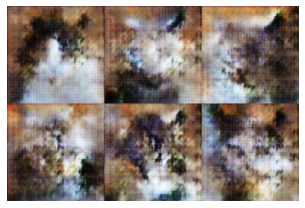

Epoch 30 | Discriminator loss: 0.55859376034248 | Generator loss: 2.730763784476689



Epoch 31 | Discriminator loss: 0.5303998934407361 | Generator loss: 2.90045103430748



Epoch 32 | Discriminator loss: 0.534976404274801 | Generator loss: 3.015043956707723



Epoch 33 | Discriminator loss: 0.22584146784888842 | Generator loss: 4.5630142244493



Epoch 34 | Discriminator loss: 0.3035322170658586 | Generator loss: 4.604465163642575



Epoch 35 | Discriminator loss: 0.37533596897345617 | Generator loss: 4.0280369795997695



Epoch 36 | Discriminator loss: 0.4359931894295136 | Generator loss: 3.66489529776277



Epoch 37 | Discriminator loss: 0.4427784973529992 | Generator loss: 3.418311482260686



Epoch 38 | Discriminator loss: 0.3547590486289259 | Generator loss: 4.003338219956581



Epoch 39 | Discriminator loss: 0.46501289317401084 | Generator loss: 3.5753046409313725


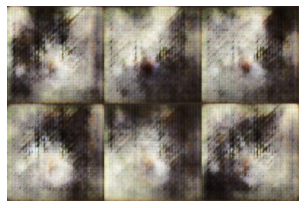

Epoch 40 | Discriminator loss: 0.36147283497907634 | Generator loss: 3.92801067436704



Epoch 41 | Discriminator loss: 0.3952219110165456 | Generator loss: 3.6503889308953137



Epoch 42 | Discriminator loss: 0.14547568158220572 | Generator loss: 5.635974395349159



Epoch 43 | Discriminator loss: 0.26705607416995136 | Generator loss: 5.279002625934826



Epoch 44 | Discriminator loss: 0.3311272029732265 | Generator loss: 4.480194292823721



Epoch 45 | Discriminator loss: 0.4249918238008963 | Generator loss: 3.914995240868989



Epoch 46 | Discriminator loss: 0.31362520564815516 | Generator loss: 4.332439958493902



Epoch 47 | Discriminator loss: 0.39152079865819006 | Generator loss: 3.8568249681721563



Epoch 48 | Discriminator loss: 0.40740348079912647 | Generator loss: 3.8467389867172477



Epoch 49 | Discriminator loss: 0.3403195406619477 | Generator loss: 3.8396987478185145


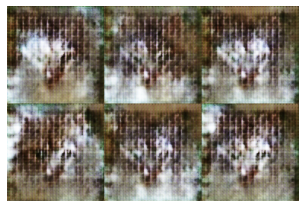

Epoch 50 | Discriminator loss: 0.35491122520153867 | Generator loss: 4.046197039370211



Epoch 51 | Discriminator loss: 0.3530562786686566 | Generator loss: 4.060178785220437



Epoch 52 | Discriminator loss: 0.34466807737635746 | Generator loss: 3.9372449430249494



Epoch 53 | Discriminator loss: 0.3539389932274582 | Generator loss: 3.8905795183241



Epoch 54 | Discriminator loss: 0.33361705975720546 | Generator loss: 4.054951707953992



Epoch 55 | Discriminator loss: 0.1571509181558987 | Generator loss: 5.682360291110803



Epoch 56 | Discriminator loss: 0.25020810768844426 | Generator loss: 4.731696737849194



Epoch 57 | Discriminator loss: 0.30762385725015606 | Generator loss: 4.4320746974915455



Epoch 58 | Discriminator loss: 0.2948691939453152 | Generator loss: 4.4709813013580275



Epoch 59 | Discriminator loss: 0.3368649287650436 | Generator loss: 4.323452175403974


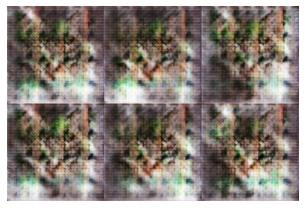

Epoch 60 | Discriminator loss: 0.32034882928155994 | Generator loss: 4.256425080092057



Epoch 61 | Discriminator loss: 0.3381094937598873 | Generator loss: 4.199255815388994



Epoch 62 | Discriminator loss: 0.3525069233137768 | Generator loss: 3.9964075356906985



Epoch 63 | Discriminator loss: 0.3552322640721639 | Generator loss: 4.043434131959951



Epoch 64 | Discriminator loss: 0.3506042269896333 | Generator loss: 4.074905917141008



Epoch 65 | Discriminator loss: 0.3201718668861767 | Generator loss: 4.104235348494156



Epoch 66 | Discriminator loss: 0.3150607084381963 | Generator loss: 4.222001760642721



Epoch 67 | Discriminator loss: 0.3302481974886584 | Generator loss: 4.102488988304731



Epoch 68 | Discriminator loss: 0.2500785258485032 | Generator loss: 5.050322339771697



Epoch 69 | Discriminator loss: 0.2684255727790475 | Generator loss: 5.358413292384296


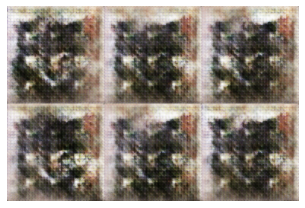

Epoch 70 | Discriminator loss: 0.334286583767293 | Generator loss: 4.434805339908007



Epoch 71 | Discriminator loss: 0.318570051546004 | Generator loss: 4.384576336382339



Epoch 72 | Discriminator loss: 0.29990452712458116 | Generator loss: 4.233465958085859



Epoch 73 | Discriminator loss: 0.33755247403519756 | Generator loss: 4.220224640569332



Epoch 74 | Discriminator loss: 0.27262067587032096 | Generator loss: 4.46245708413746



Epoch 75 | Discriminator loss: 0.33638332799654264 | Generator loss: 4.198748391607533



Epoch 76 | Discriminator loss: 0.3550920643384297 | Generator loss: 3.937578212770616



Epoch 77 | Discriminator loss: 0.3627022778928353 | Generator loss: 4.304992549908087



Epoch 78 | Discriminator loss: 0.33322173361383883 | Generator loss: 4.400240302641199



Epoch 79 | Discriminator loss: 0.32018784987185034 | Generator loss: 4.202703819696947


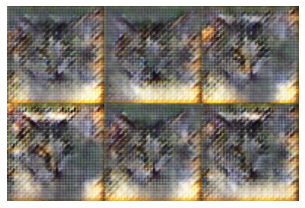

Epoch 80 | Discriminator loss: 0.30856537580359855 | Generator loss: 4.521428559137427



Epoch 81 | Discriminator loss: 0.2936079428696395 | Generator loss: 4.356122648493844



Epoch 82 | Discriminator loss: 0.282804005195429 | Generator loss: 4.4415577816667025



Epoch 83 | Discriminator loss: 0.2966450916536937 | Generator loss: 4.537280294280615



Epoch 84 | Discriminator loss: 0.31848448514909034 | Generator loss: 4.176494551741558



Epoch 85 | Discriminator loss: 0.26525556568294884 | Generator loss: 4.702117261494169



Epoch 86 | Discriminator loss: 0.2686855020304882 | Generator loss: 4.770521751657036



Epoch 87 | Discriminator loss: 0.2764517294228473 | Generator loss: 4.461294618452558



Epoch 88 | Discriminator loss: 0.31089862842601884 | Generator loss: 4.562749425446765



Epoch 89 | Discriminator loss: 0.286916542629113 | Generator loss: 4.804332281861987


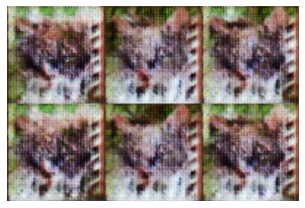

Epoch 90 | Discriminator loss: 0.2982594553997577 | Generator loss: 4.399276449813605



Epoch 91 | Discriminator loss: 0.31042238650789217 | Generator loss: 4.479036506288541



Epoch 92 | Discriminator loss: 0.3340628257509832 | Generator loss: 4.315779608599147



Epoch 93 | Discriminator loss: 0.1797119570250758 | Generator loss: 5.707020374558727



Epoch 94 | Discriminator loss: 0.24281155254565737 | Generator loss: 5.615644486794561



Epoch 95 | Discriminator loss: 0.27028118592948586 | Generator loss: 4.947745061809232



Epoch 96 | Discriminator loss: 0.28436272193007783 | Generator loss: 4.81602044061104



Epoch 97 | Discriminator loss: 0.27911511590687427 | Generator loss: 4.774977573141548



Epoch 98 | Discriminator loss: 0.29613695431506976 | Generator loss: 4.501666749486271



Epoch 99 | Discriminator loss: 0.2769955816743292 | Generator loss: 4.405507119175811


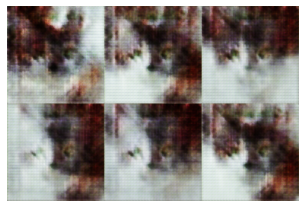

Epoch 100 | Discriminator loss: 0.2919494815689286 | Generator loss: 4.387395210147645



Epoch 101 | Discriminator loss: 0.3279979023122127 | Generator loss: 4.488729180386348



Epoch 102 | Discriminator loss: 0.28411149060149904 | Generator loss: 4.60523676983318



Epoch 103 | Discriminator loss: 0.2509957867080238 | Generator loss: 4.810541619425234



Epoch 104 | Discriminator loss: 0.2734873426815116 | Generator loss: 4.55851644018422



Epoch 105 | Discriminator loss: 0.28697596013792664 | Generator loss: 4.306656047794389



Epoch 106 | Discriminator loss: 0.16289455703310263 | Generator loss: 5.887484455700987



Epoch 107 | Discriminator loss: 0.2347737444461589 | Generator loss: 5.7778732780343995



Epoch 108 | Discriminator loss: 0.20256189124271862 | Generator loss: 5.16357417950719



Epoch 109 | Discriminator loss: 0.24281646127560622 | Generator loss: 5.2985516482998865


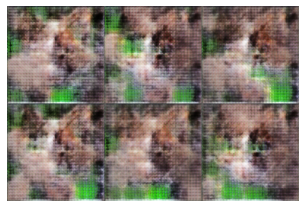

Epoch 110 | Discriminator loss: 0.26737144930844703 | Generator loss: 4.793287977668809



Epoch 111 | Discriminator loss: 0.2690595821204221 | Generator loss: 4.606036688230052



Epoch 112 | Discriminator loss: 0.28051766420401547 | Generator loss: 4.7750493393551485



Epoch 113 | Discriminator loss: 0.2825152356837498 | Generator loss: 4.546656061773715



Epoch 114 | Discriminator loss: 0.3030083860446541 | Generator loss: 4.51313406784342



Epoch 115 | Discriminator loss: 0.289669168860899 | Generator loss: 4.538435618329492



Epoch 116 | Discriminator loss: 0.29267235334165986 | Generator loss: 4.624879045516067



Epoch 117 | Discriminator loss: 0.31657988741230253 | Generator loss: 4.266998762669771



Epoch 118 | Discriminator loss: 0.29461266492637056 | Generator loss: 4.445321432366875



Epoch 119 | Discriminator loss: 0.34123371928122553 | Generator loss: 4.472715150125278


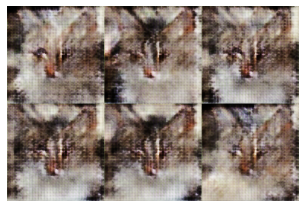

Epoch 120 | Discriminator loss: 0.3093649215768677 | Generator loss: 4.315713357851372


In [52]:
train_gan()

### Задание 3 (5 баллов)
Теперь посмотрим на другую модель: Variational Autoencoder. В отличии от GAN, в котором генератор пытается себя обмануть дискриминатор, а дискриминатор старается не быть обманутым, VAE решает задачу реконструкции элемента множества X с применением регуляризации в латентном пространстве. 

Полностью архитектура выглядит так:
![](imgs/VAE.png)

Из нее можно выделить две части: Encoder (по изображению возвращает mu и sigma) и Decoder (по случайному шуму восстанавливает изображение). На высоком уровне VAE можно представить так:

![](imgs/VAE_highlevel.png)

В данном задании вам необходимо реализовать полную архитектуру VAE.

#### Методы
* `__init__` - принимает на вход `img_size`, `downsamplings`, `latent_size`, `linear_hidden_size`, `down_channels` и `up_channels`. `img_size` - размер стороны входного изображения. `downsamplings` - количество downsampling (и upsampling) блоков. `latent_size` - размер латентного пространства, в котором в который будет закодирована картинка. `linear_hidden_size` количество нейронов на скрытом слое полносвязной сети в конце encoder'а. Для полносвязной сети decoder'а это число стоит умножить на 2. `down_channels` - количество каналов, в которое будет преобразовано трехцветное изображение перед применением `downsampling` блоков. `up_channels` - количество каналов, которое должно получиться после применения всех upsampling блоков.

* `forward` - принимает на вход `x`. Считает распределение $N(\mu, \sigma^2)$ и вектор $z \sim N(\mu, \sigma^2)$. Возвращает $x'$ - восстановленную из вектора $z$ картинку и $D_{KL}(N(\mu, \sigma^2), N(0, 1)) = 0.5 \cdot (\sigma^2 + \mu^2 - \log \sigma^2 - 1)$.

* `encode` - принимает на вход `x`. Возвращает вектор из распределения $N(\mu, \sigma^2)$.

* `decode` - принимает на вход `z`. Возвращает восстановленную по вектору картинку.


#### Если хочется улучшить качество
https://arxiv.org/pdf/1906.00446.pdf

In [26]:
class VAE(nn.Module):
    def __init__(self, img_size=128, downsamplings=7, latent_size=512, linear_hidden_size=1024, down_channels=8, up_channels=16):
        super().__init__()
        self.img_size = img_size
        self.downsamplings = downsamplings
        self.latent_size = latent_size
        self.linear_hidden_size = linear_hidden_size
        self.down_channels = down_channels
        self.up_channels = up_channels
        # downsamplings blocks
        conv1 = nn.Conv2d(3, self.down_channels, kernel_size=1, stride=1, padding=0)
        self.conv_blocks = []
        c = self.down_channels
        for i in range(self.downsamplings):
          c_ = c * 2
          self.conv_blocks += [nn.Conv2d(c, c_, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(c_),
            nn.ReLU()]
          c = c_ 
        conv2 = nn.Conv2d(self.linear_hidden_size, self.linear_hidden_size*2, kernel_size=1, stride=1, padding=0)
        self.conv_blocks = [conv1] + self.conv_blocks + [conv2]
        self.blocks = nn.Sequential(*self.conv_blocks)
        # upsamplings blocks
        conv3 = nn.Conv2d(self.linear_hidden_size, self.latent_size, kernel_size=1, stride=1, padding=0)
        self.conv_layers = []
        c = self.latent_size
        for j in range(self.downsamplings):
          c_ = c // 2
          self.conv_layers += [nn.ConvTranspose2d(c, c_, kernel_size=4, stride=2, padding=1),\
                nn.BatchNorm2d(c_),\
                nn.ReLU()]
          c = c_   
        conv4 = nn.Conv2d(4, 3, kernel_size=1, stride=1, padding=0)
        tanh = nn.Tanh()
        self.conv_layers = [conv3] + self.conv_layers + [conv4] + [tanh]
        self.layers = nn.Sequential(* self.conv_layers)


    def encoder(self, x):
        x = self.blocks(x)
        mu, sigma = torch.split(x, self.linear_hidden_size, dim=1)
        sigma = torch.exp(sigma)
        return mu, sigma


    def decoder(self, x):
        x = self.layers(x)
        return x


    def encode(self, x):     
        self.mu, self.sigma = self.encoder(x)      
        embading = torch.randn_like(self.sigma).cuda() * self.sigma + self.mu
        return embading


    def decode(self, z):
        z = self.decoder(z)
        return z 


    def forward(self, x):
        x = self.encode(x) 
        x_pred = self.decode(x)
        kld = 0.5 * (self.sigma**2 + self.mu**2 - torch.log(self.sigma**2) - 1)
        return x_pred, kld 


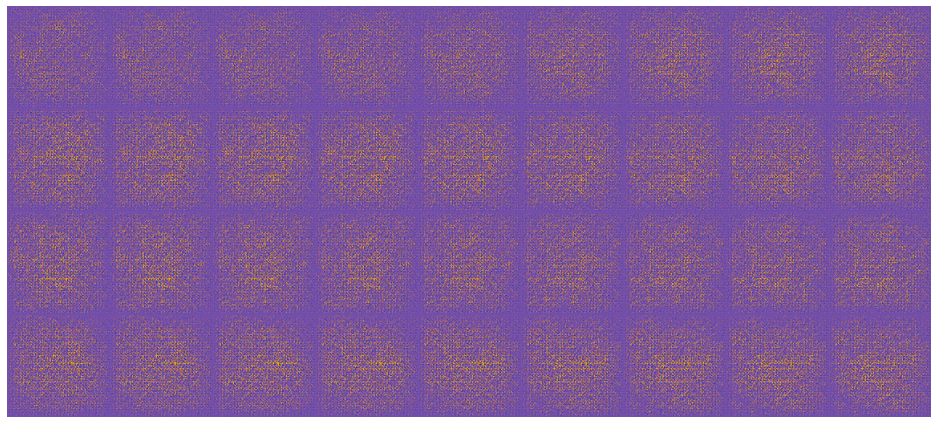

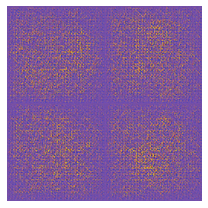


Epoch 1 | Reconstruction loss: 13512.147564810995 | KLD loss: 295.73231499239523



Epoch 2 | Reconstruction loss: 8845.242529448515 | KLD loss: 506.61951437055694



Epoch 3 | Reconstruction loss: 7230.89451002038 | KLD loss: 618.9278080152428



Epoch 4 | Reconstruction loss: 6470.678484235491 | KLD loss: 688.8174215755107



Epoch 5 | Reconstruction loss: 6049.02932985673 | KLD loss: 720.1466660588425



Epoch 6 | Reconstruction loss: 5767.579049625752 | KLD loss: 759.2809279542532



Epoch 7 | Reconstruction loss: 5565.6718696925955 | KLD loss: 784.2084454838533



Epoch 8 | Reconstruction loss: 5412.708421410981 | KLD loss: 805.917049621203



Epoch 9 | Reconstruction loss: 5278.160718076718 | KLD loss: 829.0535682062184



Epoch 10 | Reconstruction loss: 5179.913081767396 | KLD loss: 840.5630365217695


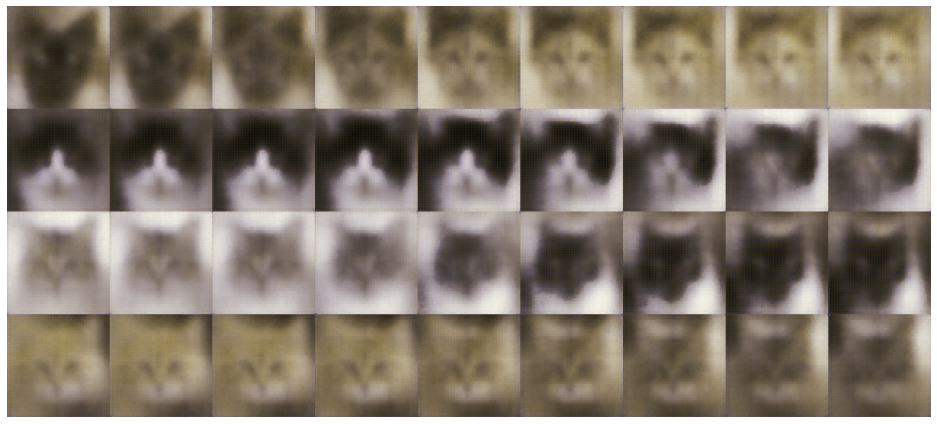

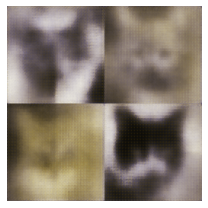


Epoch 11 | Reconstruction loss: 5117.3857156504755 | KLD loss: 854.549780898953



Epoch 12 | Reconstruction loss: 5067.194181264557 | KLD loss: 857.5263728740052



Epoch 13 | Reconstruction loss: 5011.416140728115 | KLD loss: 865.8591686746348



Epoch 14 | Reconstruction loss: 4948.397930263733 | KLD loss: 868.4856427115683



Epoch 15 | Reconstruction loss: 4861.535786693881 | KLD loss: 872.9746507917132



Epoch 16 | Reconstruction loss: 4822.125774881114 | KLD loss: 880.6985830934892



Epoch 17 | Reconstruction loss: 4774.027043881623 | KLD loss: 889.8273207386088



Epoch 18 | Reconstruction loss: 4736.927334803232 | KLD loss: 899.0841502314029



Epoch 19 | Reconstruction loss: 4670.397202391062 | KLD loss: 903.6586427866301



Epoch 20 | Reconstruction loss: 4649.704342670322 | KLD loss: 909.5988452034708


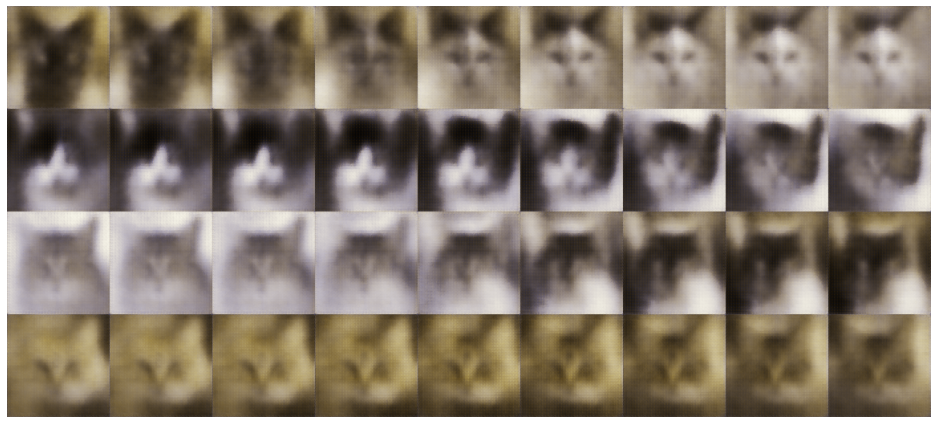

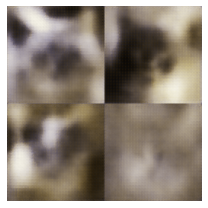


Epoch 21 | Reconstruction loss: 4590.164151588582 | KLD loss: 911.0572264298149



Epoch 22 | Reconstruction loss: 4549.7615151731125 | KLD loss: 908.9857010930222



Epoch 23 | Reconstruction loss: 4539.944210834385 | KLD loss: 919.6248685469538



Epoch 24 | Reconstruction loss: 4495.494579623205 | KLD loss: 921.0915337793575



Epoch 25 | Reconstruction loss: 4460.848754503712 | KLD loss: 928.931542911885



Epoch 26 | Reconstruction loss: 4442.460151624976 | KLD loss: 929.0514655261306



Epoch 27 | Reconstruction loss: 4393.844305761112 | KLD loss: 931.7476032328161



Epoch 28 | Reconstruction loss: 4371.677110375825 | KLD loss: 934.7745516759268



Epoch 29 | Reconstruction loss: 4365.483780191552 | KLD loss: 942.7228149034962



Epoch 30 | Reconstruction loss: 4302.833035486826 | KLD loss: 934.9454015885821


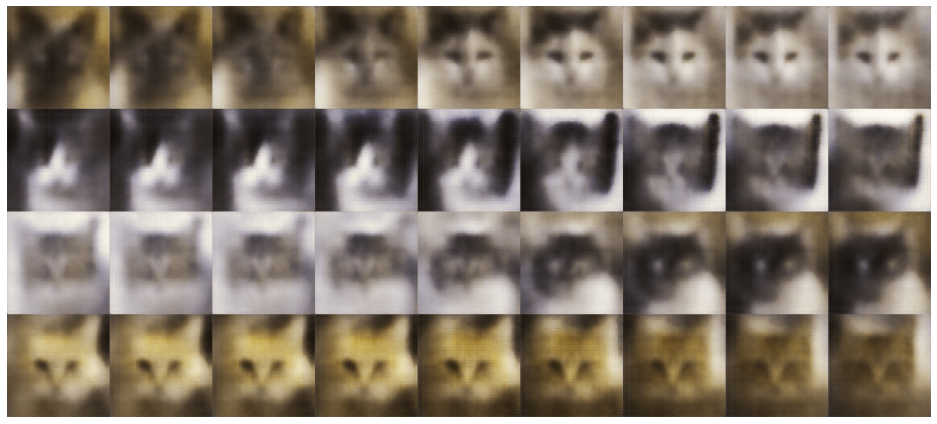

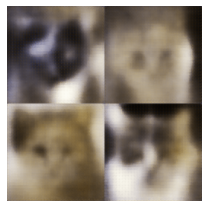


Epoch 31 | Reconstruction loss: 4253.048902049568 | KLD loss: 943.1856024132012



Epoch 32 | Reconstruction loss: 4272.247817519288 | KLD loss: 939.8007143387883



Epoch 33 | Reconstruction loss: 4244.9827278089815 | KLD loss: 948.727858075444



Epoch 34 | Reconstruction loss: 4202.590012449656 | KLD loss: 947.9058808510348



Epoch 35 | Reconstruction loss: 4182.651187493934 | KLD loss: 942.3811941206085



Epoch 36 | Reconstruction loss: 4160.7391819924305 | KLD loss: 950.9925357036709



Epoch 37 | Reconstruction loss: 4136.2250779430315 | KLD loss: 947.4126668420638



Epoch 38 | Reconstruction loss: 4108.99284903011 | KLD loss: 951.2514393492515



Epoch 39 | Reconstruction loss: 4098.507743882837 | KLD loss: 952.7882067757364



Epoch 40 | Reconstruction loss: 4072.2964917295467 | KLD loss: 950.5369177397733


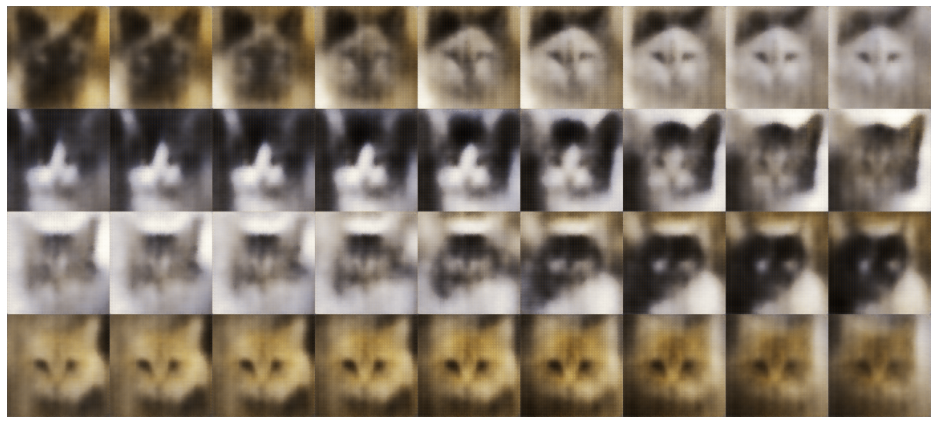

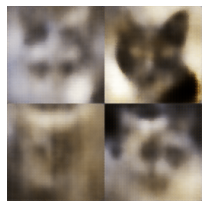


Epoch 41 | Reconstruction loss: 4049.715452585161 | KLD loss: 950.0237376527016



Epoch 42 | Reconstruction loss: 4017.711305227339 | KLD loss: 955.1234044614046



Epoch 43 | Reconstruction loss: 4004.7183720369517 | KLD loss: 958.4671448891207



Epoch 44 | Reconstruction loss: 4004.116923646157 | KLD loss: 954.7555662356549



Epoch 45 | Reconstruction loss: 3993.898970515091 | KLD loss: 962.0050128439199



Epoch 46 | Reconstruction loss: 3958.297930415373 | KLD loss: 960.5738540554639



Epoch 47 | Reconstruction loss: 3949.5837504700844 | KLD loss: 960.0809115771181



Epoch 48 | Reconstruction loss: 3919.8936570445944 | KLD loss: 961.1607787327737



Epoch 49 | Reconstruction loss: 3907.7122378141985 | KLD loss: 958.2784164144385



Epoch 50 | Reconstruction loss: 3918.443603515625 | KLD loss: 957.0911820690084


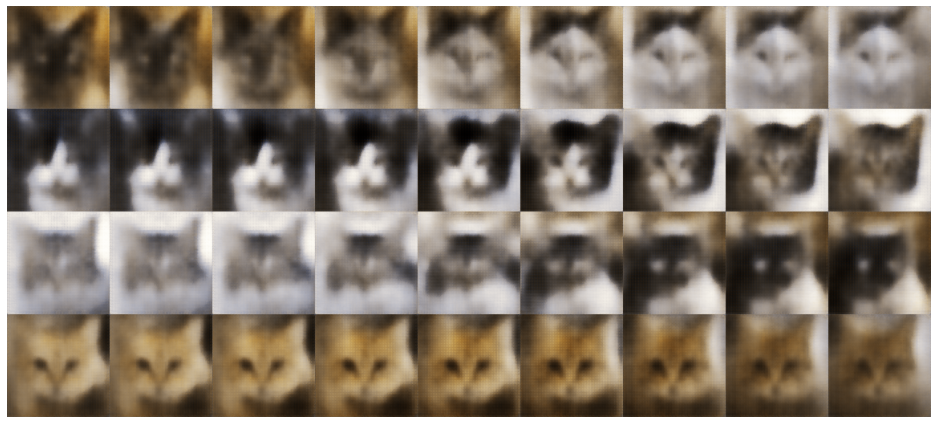

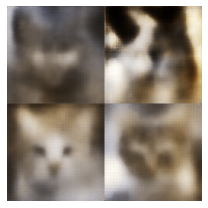


Epoch 51 | Reconstruction loss: 3871.4844049489275 | KLD loss: 952.6257794303183



Epoch 52 | Reconstruction loss: 3852.147648971273 | KLD loss: 954.8325385810425



Epoch 53 | Reconstruction loss: 3864.665123601878 | KLD loss: 952.1447206106245



Epoch 54 | Reconstruction loss: 3843.058795431386 | KLD loss: 956.2308986497962



Epoch 55 | Reconstruction loss: 3808.685265582541 | KLD loss: 949.2674310340644



Epoch 56 | Reconstruction loss: 3804.035686990489 | KLD loss: 956.3050241411103



Epoch 57 | Reconstruction loss: 3814.937158430585 | KLD loss: 951.5340477605785



Epoch 58 | Reconstruction loss: 3778.49416223372 | KLD loss: 946.685819163826



Epoch 59 | Reconstruction loss: 3784.1409460979958 | KLD loss: 956.6915829107628



Epoch 60 | Reconstruction loss: 3783.392916661612 | KLD loss: 951.3881581940266


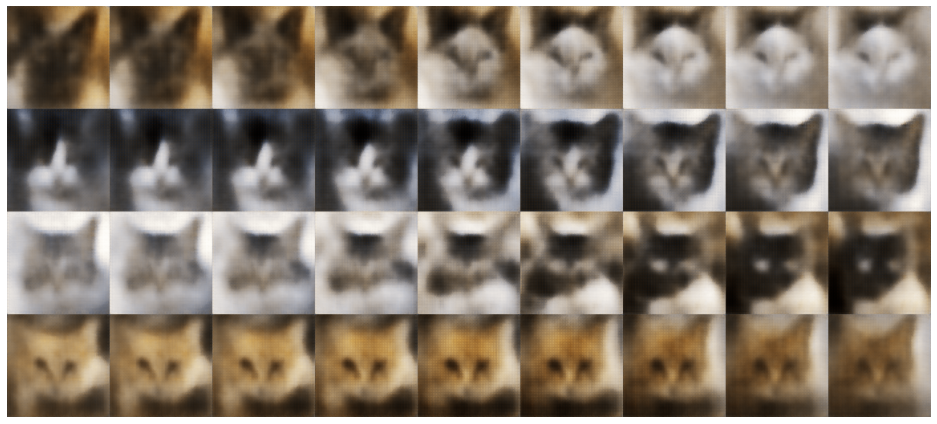

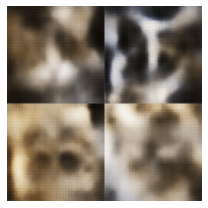


Epoch 61 | Reconstruction loss: 3758.165139903193 | KLD loss: 948.9032099942983



Epoch 62 | Reconstruction loss: 3758.1119464376698 | KLD loss: 946.459545348742



Epoch 63 | Reconstruction loss: 3744.539620535714 | KLD loss: 949.4573119738087



Epoch 64 | Reconstruction loss: 3713.1164080696817 | KLD loss: 942.2819720913905



Epoch 65 | Reconstruction loss: 3711.740369334724 | KLD loss: 946.4227031447132



Epoch 66 | Reconstruction loss: 3705.7938092154745 | KLD loss: 946.2536667533543



Epoch 67 | Reconstruction loss: 3686.2720636403337 | KLD loss: 937.3735318391219



Epoch 68 | Reconstruction loss: 3678.574734326475 | KLD loss: 943.5933608534914



Epoch 69 | Reconstruction loss: 3669.2309331479278 | KLD loss: 939.927229792435



Epoch 70 | Reconstruction loss: 3648.555852096273 | KLD loss: 939.3394220008613


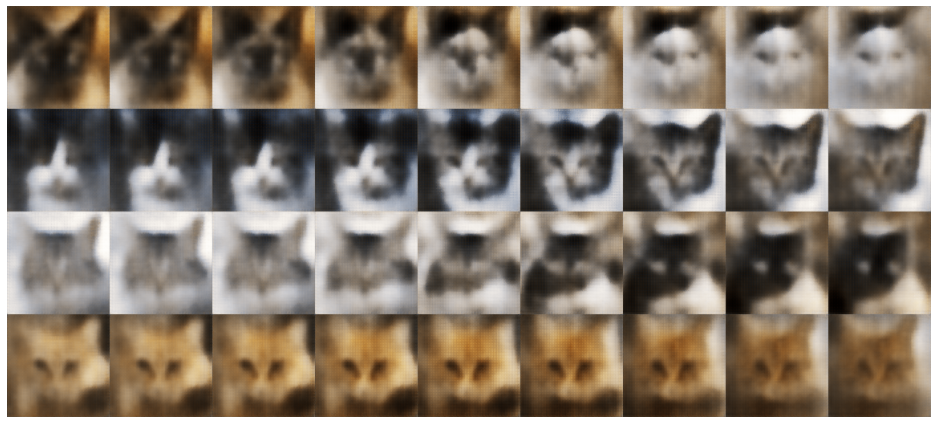

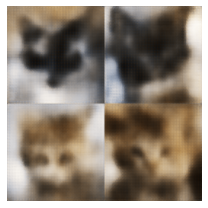


Epoch 71 | Reconstruction loss: 3646.3492996500145 | KLD loss: 941.4897574667605



Epoch 72 | Reconstruction loss: 3636.1435956303376 | KLD loss: 940.0543082101004



Epoch 73 | Reconstruction loss: 3647.2567256192983 | KLD loss: 943.5191028666052



Epoch 74 | Reconstruction loss: 3629.0604304911926 | KLD loss: 947.4631337230991



Epoch 75 | Reconstruction loss: 3615.703257306022 | KLD loss: 939.4669742939635



Epoch 76 | Reconstruction loss: 3606.6257164996605 | KLD loss: 941.2583284555755



Epoch 77 | Reconstruction loss: 3597.6249871105883 | KLD loss: 935.0297086727545



Epoch 78 | Reconstruction loss: 3587.433914089795 | KLD loss: 939.315725954423



Epoch 79 | Reconstruction loss: 3595.4858697926775 | KLD loss: 935.8448629438507



Epoch 80 | Reconstruction loss: 3568.626928104377 | KLD loss: 934.2989310507448


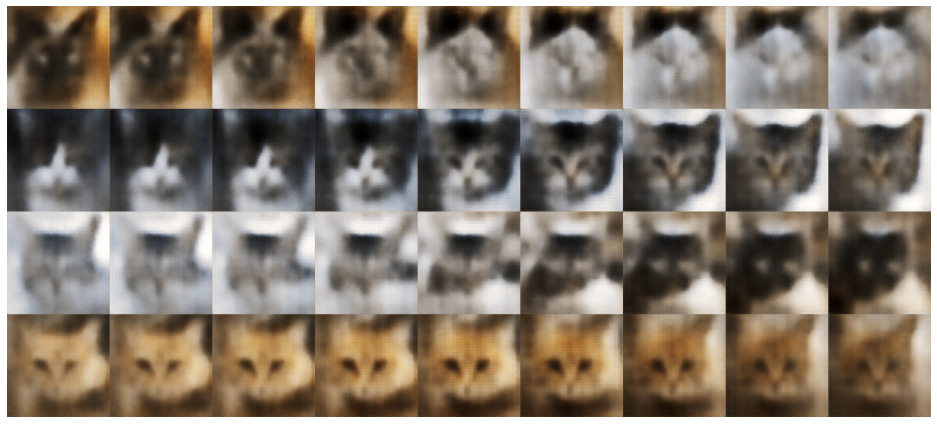

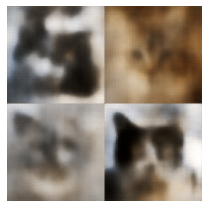


Epoch 81 | Reconstruction loss: 3573.3173191236415 | KLD loss: 933.764066897564



Epoch 82 | Reconstruction loss: 3560.0681580727146 | KLD loss: 931.00249021542



Epoch 83 | Reconstruction loss: 3548.0460792683666 | KLD loss: 933.1958389756102



Epoch 84 | Reconstruction loss: 3537.338348199122 | KLD loss: 932.1961020712527



Epoch 85 | Reconstruction loss: 3547.4198760038576 | KLD loss: 930.7741306849888



Epoch 86 | Reconstruction loss: 3522.824990598311 | KLD loss: 928.9639708714456



Epoch 87 | Reconstruction loss: 3520.238202776228 | KLD loss: 929.608187847256



Epoch 88 | Reconstruction loss: 3521.1143832947155 | KLD loss: 927.5383248654952



Epoch 89 | Reconstruction loss: 3488.744853333657 | KLD loss: 929.9462028171705



Epoch 90 | Reconstruction loss: 3503.5447414232335 | KLD loss: 931.8601934776543


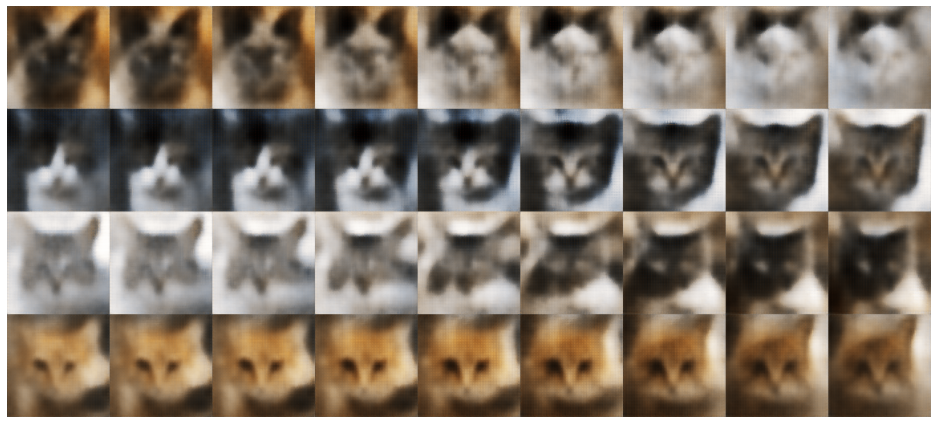

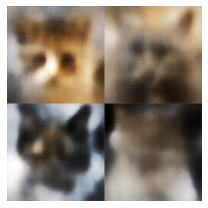


Epoch 91 | Reconstruction loss: 3472.162202633686 | KLD loss: 926.4912030711678



Epoch 92 | Reconstruction loss: 3480.171754446089 | KLD loss: 926.0001449111086



Epoch 93 | Reconstruction loss: 3463.3927058818176 | KLD loss: 919.984763483083



Epoch 94 | Reconstruction loss: 3470.157156808036 | KLD loss: 926.055880054924



Epoch 95 | Reconstruction loss: 3469.8756179335696 | KLD loss: 924.0626454797591



Epoch 96 | Reconstruction loss: 3453.2260389624175 | KLD loss: 921.538097784386



Epoch 97 | Reconstruction loss: 3439.930580660423 | KLD loss: 920.4238029148268



Epoch 98 | Reconstruction loss: 3454.006162276179 | KLD loss: 924.146254355863



Epoch 99 | Reconstruction loss: 3443.7834749399503 | KLD loss: 919.3177196431604



Epoch 100 | Reconstruction loss: 3438.240843968362 | KLD loss: 916.1858860750376


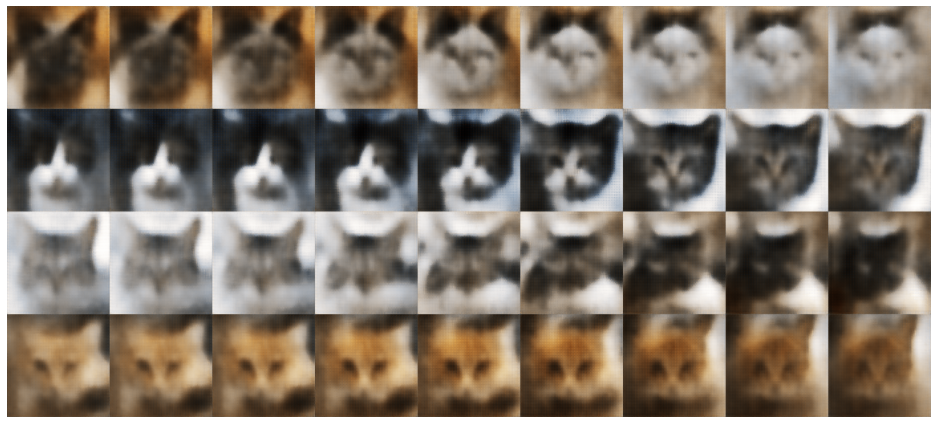

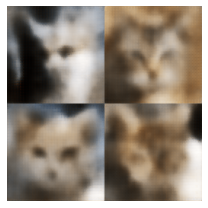


Epoch 101 | Reconstruction loss: 3434.4823115567983 | KLD loss: 924.0535380677406



Epoch 102 | Reconstruction loss: 3428.8306801363547 | KLD loss: 915.3273890714468



Epoch 103 | Reconstruction loss: 3425.1448239154697 | KLD loss: 915.8818507224137



Epoch 104 | Reconstruction loss: 3415.978643760918 | KLD loss: 916.9295675147395



Epoch 105 | Reconstruction loss: 3411.0854094132133 | KLD loss: 908.6931898223687



Epoch 106 | Reconstruction loss: 3388.665945112335 | KLD loss: 914.3513366509669



Epoch 107 | Reconstruction loss: 3389.5586259735296 | KLD loss: 918.1446296265407



Epoch 108 | Reconstruction loss: 3386.516641747137 | KLD loss: 910.8231830478455



Epoch 109 | Reconstruction loss: 3373.1800669794497 | KLD loss: 903.7420311211059



Epoch 110 | Reconstruction loss: 3385.2297962259804 | KLD loss: 909.3246250507995


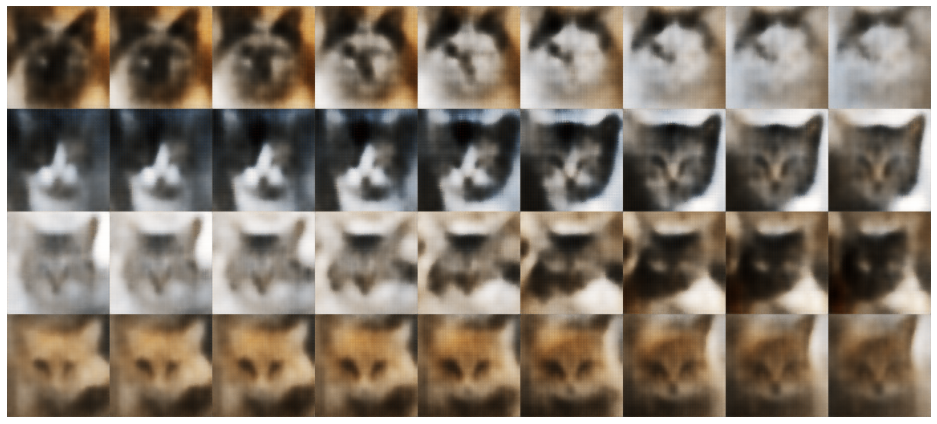

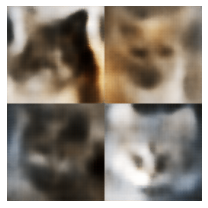


Epoch 111 | Reconstruction loss: 3364.477819975859 | KLD loss: 911.441620062597



Epoch 112 | Reconstruction loss: 3380.404080787801 | KLD loss: 910.6799795020441



Epoch 113 | Reconstruction loss: 3350.34838298537 | KLD loss: 906.4901948537886



Epoch 114 | Reconstruction loss: 3357.6399162718967 | KLD loss: 904.009249100774



Epoch 115 | Reconstruction loss: 3348.91469180658 | KLD loss: 901.8539293182563



Epoch 116 | Reconstruction loss: 3355.8837371257523 | KLD loss: 904.8434816917277



Epoch 117 | Reconstruction loss: 3327.628603727921 | KLD loss: 899.2985109127826



Epoch 118 | Reconstruction loss: 3332.9909546656636 | KLD loss: 902.6373134636731



Epoch 119 | Reconstruction loss: 3326.7995544812693 | KLD loss: 899.5160022996228



Epoch 120 | Reconstruction loss: 3332.593303798889 | KLD loss: 900.5138176390843


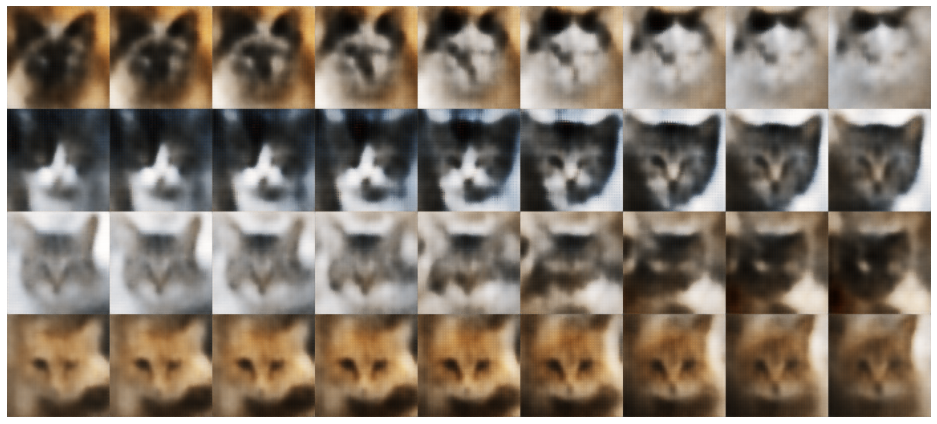

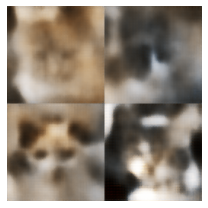


Epoch 121 | Reconstruction loss: 3331.6297887956134 | KLD loss: 899.908069681677



Epoch 122 | Reconstruction loss: 3312.3879891152706 | KLD loss: 896.8636039591725



Epoch 123 | Reconstruction loss: 3310.607394579775 | KLD loss: 895.7392528841955



Epoch 124 | Reconstruction loss: 3319.2533849870197 | KLD loss: 892.2986885212963



Epoch 125 | Reconstruction loss: 3312.559144203707 | KLD loss: 898.367681278205



Epoch 126 | Reconstruction loss: 3291.860441409283 | KLD loss: 896.5751746515309



Epoch 127 | Reconstruction loss: 3299.2480472541 | KLD loss: 892.5087339033992



Epoch 128 | Reconstruction loss: 3292.372595745584 | KLD loss: 895.5624870158131



Epoch 129 | Reconstruction loss: 3282.1262896993885 | KLD loss: 896.2120311097328



Epoch 130 | Reconstruction loss: 3293.629539726684 | KLD loss: 892.3310212318942


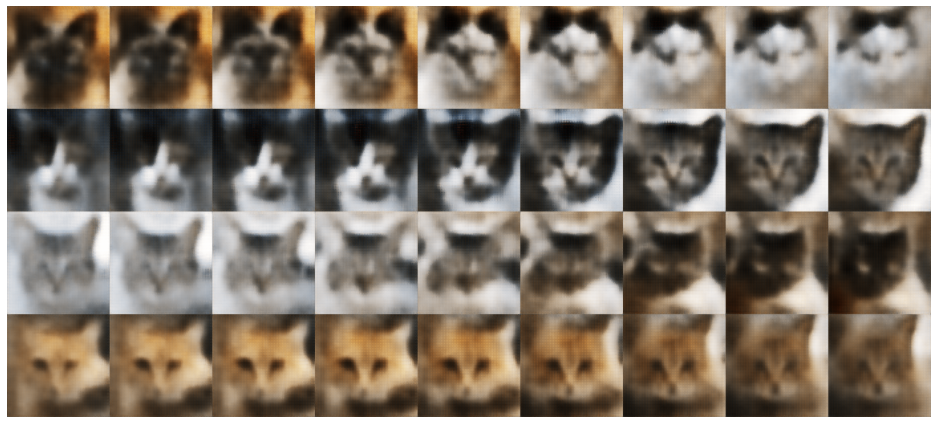

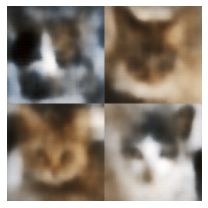


Epoch 131 | Reconstruction loss: 3265.1259488881747 | KLD loss: 889.5995191491169



Epoch 132 | Reconstruction loss: 3263.492640145817 | KLD loss: 887.2685639754585



Epoch 133 | Reconstruction loss: 3268.1338133249224 | KLD loss: 889.3074368305088



Epoch 134 | Reconstruction loss: 3266.5934228363985 | KLD loss: 885.753626284392



Epoch 135 | Reconstruction loss: 3272.3880103448905 | KLD loss: 882.4138297323855



Epoch 136 | Reconstruction loss: 3257.3621124836227 | KLD loss: 878.893114172894



Epoch 137 | Reconstruction loss: 3262.7472147497333 | KLD loss: 887.2947828399468



Epoch 138 | Reconstruction loss: 3244.645468386064 | KLD loss: 885.0343622243182



Epoch 139 | Reconstruction loss: 3244.359055039305 | KLD loss: 879.1751970563616



Epoch 140 | Reconstruction loss: 3250.862826329581 | KLD loss: 878.617836425023


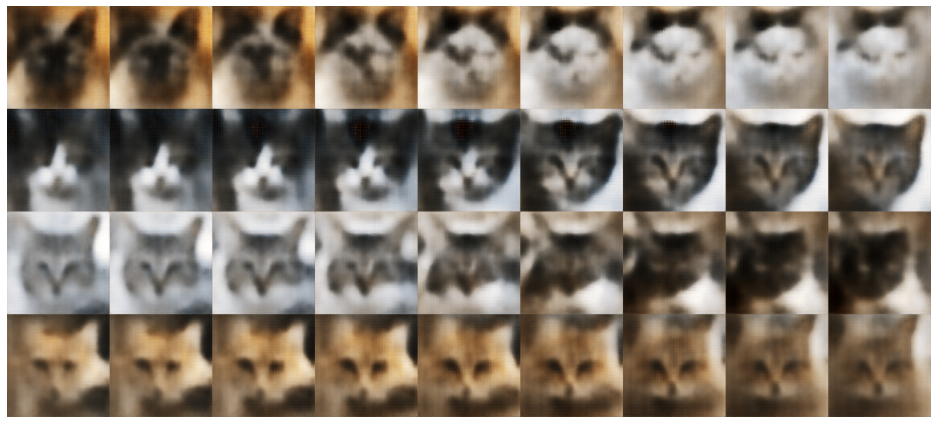

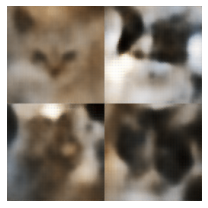


Epoch 141 | Reconstruction loss: 3239.8221651634076 | KLD loss: 882.7831717544461



Epoch 142 | Reconstruction loss: 3232.3223213527513 | KLD loss: 884.4149526276203



Epoch 143 | Reconstruction loss: 3216.533373341057 | KLD loss: 881.285599039208



Epoch 144 | Reconstruction loss: 3213.5005117854716 | KLD loss: 883.3739321690908



Epoch 145 | Reconstruction loss: 3215.4056006011015 | KLD loss: 874.5476538616678



Epoch 146 | Reconstruction loss: 3221.794647595897 | KLD loss: 881.0158412767494



Epoch 147 | Reconstruction loss: 3204.6385888520235 | KLD loss: 872.929838287164



Epoch 148 | Reconstruction loss: 3219.1606439625994 | KLD loss: 874.6306969305003



Epoch 149 | Reconstruction loss: 3209.5040840480638 | KLD loss: 872.9380853309394



Epoch 150 | Reconstruction loss: 3194.584693861304 | KLD loss: 873.6462485745827


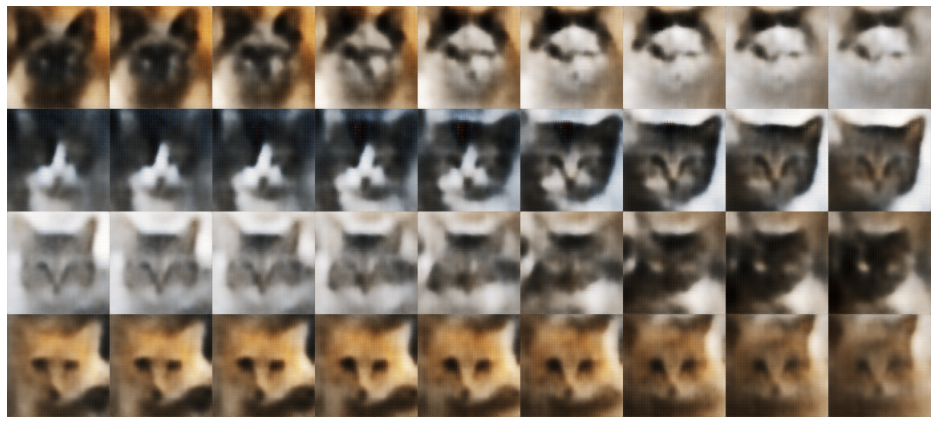

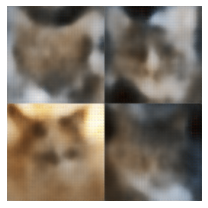


Epoch 151 | Reconstruction loss: 3189.093017957225 | KLD loss: 871.6549618170128



Epoch 152 | Reconstruction loss: 3191.11031895987 | KLD loss: 872.2379192091663



Epoch 153 | Reconstruction loss: 3188.119025378494 | KLD loss: 873.9096979176776



Epoch 154 | Reconstruction loss: 3185.1415663061675 | KLD loss: 875.6547368209555



Epoch 155 | Reconstruction loss: 3180.4615398904552 | KLD loss: 872.8900803275731



Epoch 156 | Reconstruction loss: 3181.3654879931337 | KLD loss: 868.3377109314343



Epoch 157 | Reconstruction loss: 3167.797085400694 | KLD loss: 867.4457770874782



Epoch 158 | Reconstruction loss: 3176.136215304736 | KLD loss: 869.8063781927831



Epoch 159 | Reconstruction loss: 3169.4560361115828 | KLD loss: 866.0236431619395



Epoch 160 | Reconstruction loss: 3158.855814868619 | KLD loss: 868.6046195652174


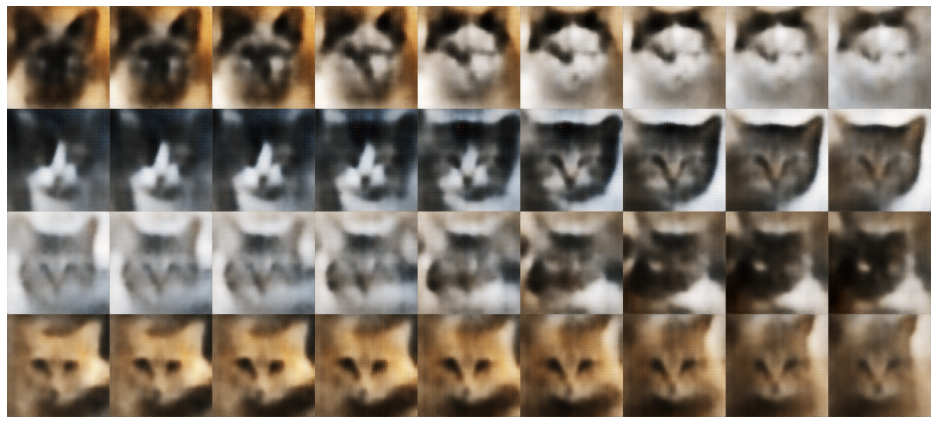

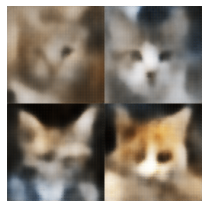


Epoch 161 | Reconstruction loss: 3161.213918366047 | KLD loss: 866.1177548236728



Epoch 162 | Reconstruction loss: 3169.556785820434 | KLD loss: 871.5086798815994



Epoch 163 | Reconstruction loss: 3150.224565020259 | KLD loss: 865.4127610485006



Epoch 164 | Reconstruction loss: 3140.9456408009028 | KLD loss: 864.8054642766159



Epoch 165 | Reconstruction loss: 3151.3989079635335 | KLD loss: 861.0532462552468



Epoch 166 | Reconstruction loss: 3148.358518612311 | KLD loss: 862.5633500377584



Epoch 167 | Reconstruction loss: 3146.39045137204 | KLD loss: 861.539915381011



Epoch 168 | Reconstruction loss: 3133.189868808533 | KLD loss: 861.6269342647577



Epoch 169 | Reconstruction loss: 3122.9443950771547 | KLD loss: 862.9202342536879



Epoch 170 | Reconstruction loss: 3120.8042401615876 | KLD loss: 862.3097550291452


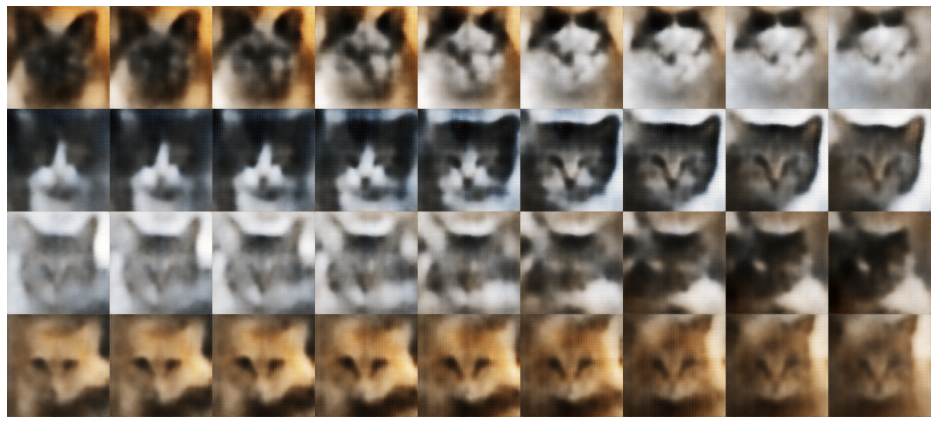

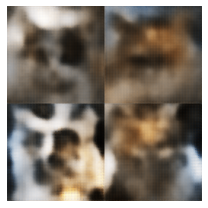


Epoch 171 | Reconstruction loss: 3130.921950061869 | KLD loss: 860.6904886376043



Epoch 172 | Reconstruction loss: 3117.676694881842 | KLD loss: 857.9144644411455



Epoch 173 | Reconstruction loss: 3129.5760664851027 | KLD loss: 854.7108601635288



Epoch 174 | Reconstruction loss: 3115.1975776245877 | KLD loss: 858.7250690341737



Epoch 175 | Reconstruction loss: 3108.955521672409 | KLD loss: 854.4628702483562



Epoch 176 | Reconstruction loss: 3100.2104423949436 | KLD loss: 854.1496769685923



Epoch 177 | Reconstruction loss: 3124.8261589855883 | KLD loss: 857.0214238137191



Epoch 178 | Reconstruction loss: 3107.6496676806337 | KLD loss: 850.0270056872635



Epoch 179 | Reconstruction loss: 3116.427917859569 | KLD loss: 851.8447818163759



Epoch 180 | Reconstruction loss: 3101.8820827318273 | KLD loss: 853.5228234522091


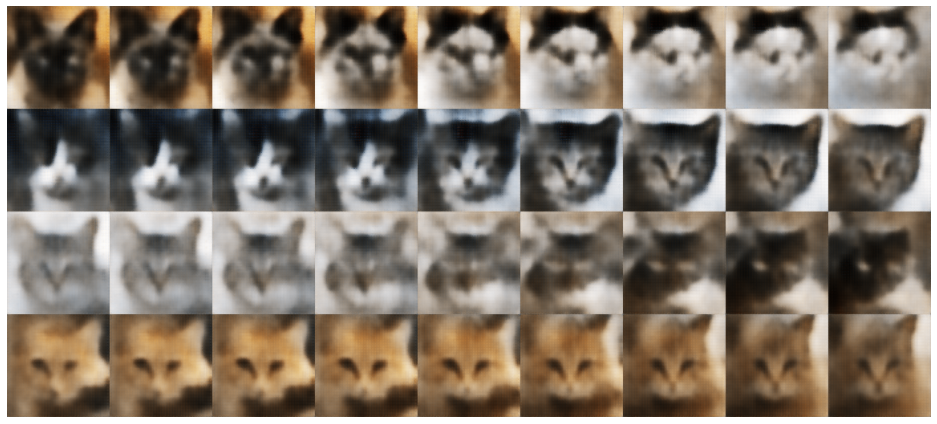

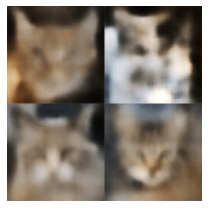


Epoch 181 | Reconstruction loss: 3085.3741115783314 | KLD loss: 850.0203886802152



Epoch 182 | Reconstruction loss: 3098.2481429769387 | KLD loss: 854.8377906372829



Epoch 183 | Reconstruction loss: 3084.2915084554543 | KLD loss: 854.738940979383



Epoch 184 | Reconstruction loss: 3080.8855875145573 | KLD loss: 847.6400457346662



Epoch 185 | Reconstruction loss: 3086.866044891547 | KLD loss: 849.5037889184418



Epoch 186 | Reconstruction loss: 3080.0155235906564 | KLD loss: 845.6638717177492



Epoch 187 | Reconstruction loss: 3081.7283795279745 | KLD loss: 849.5687349686712



Epoch 188 | Reconstruction loss: 3079.1830757093726 | KLD loss: 841.4411925321781



Epoch 189 | Reconstruction loss: 3068.0695728752185 | KLD loss: 845.1549796347292



Epoch 190 | Reconstruction loss: 3066.8747573757764 | KLD loss: 846.6564657080988


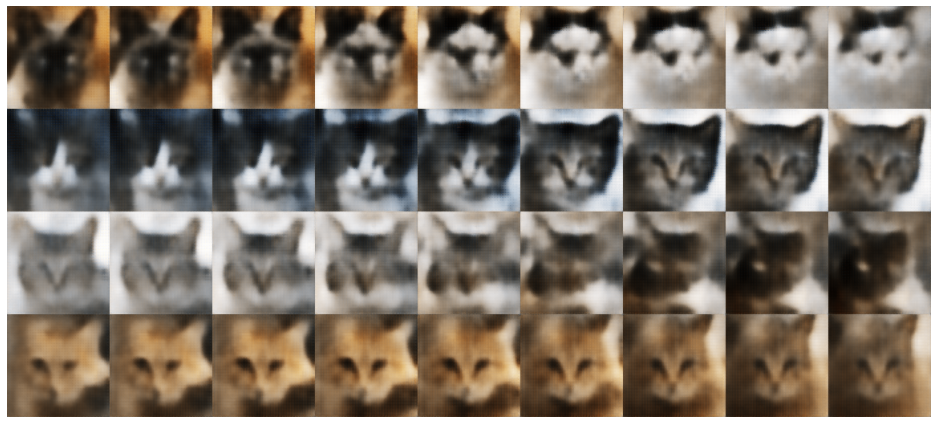

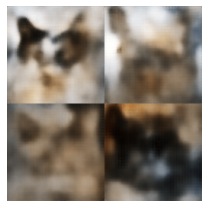


Epoch 191 | Reconstruction loss: 3064.268119290749 | KLD loss: 842.2432764657536



Epoch 192 | Reconstruction loss: 3070.5994092100154 | KLD loss: 842.6302515823648



Epoch 193 | Reconstruction loss: 3061.334077633686 | KLD loss: 840.7132973048998



Epoch 194 | Reconstruction loss: 3063.0422630546996 | KLD loss: 843.832548911527



Epoch 195 | Reconstruction loss: 3056.7610066099937 | KLD loss: 840.7373180507873



Epoch 196 | Reconstruction loss: 3053.887707064611 | KLD loss: 837.6487149066807



Epoch 197 | Reconstruction loss: 3053.691234707092 | KLD loss: 841.772746400063



Epoch 198 | Reconstruction loss: 3046.4387220299764 | KLD loss: 838.9812625861316



Epoch 199 | Reconstruction loss: 3056.780018682065 | KLD loss: 838.2482575600192



Epoch 200 | Reconstruction loss: 3043.8918915742674 | KLD loss: 836.6334219985868


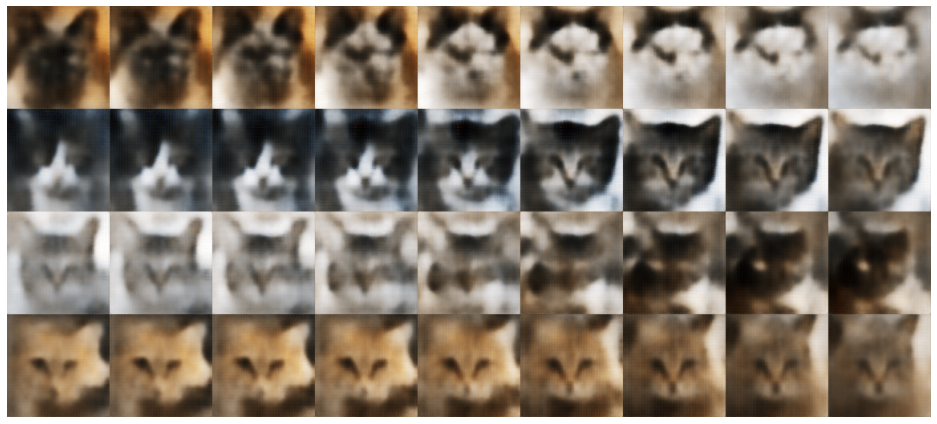

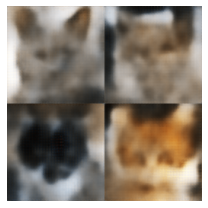


Epoch 201 | Reconstruction loss: 3047.1062811620486 | KLD loss: 840.2032441322848


In [28]:
def train_vae():
    vae = VAE()
    vae.cuda()

    epochs = 201
    batch_size = 8
    vae_optim = Adam(vae.parameters(), lr=1e-4)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0

        if ep % 10 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.cuda())
                z_2 = vae.encode(test_imgs_2.cuda())

                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)
                visualise(x_int, rows=len(test_imgs_1))
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)
                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.cuda()
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.1 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")

train_vae()